In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go


In [2]:
# Load file
try:
    data = pd.read_csv('../vehicles_us.csv')
except Exception as e:
    print("Filename doesn't exist!")

In [3]:
# Split the make and model information in the 'model' column into 'make' and 'model' columns
data['make'] = data['model'].str.split(' ').str[0]
data['model_only'] = data['model'].str.split(' ').str[1]

# Datetime datatypes
data['date_posted'] = pd.to_datetime(data['date_posted'], errors='coerce')
data['year'] = data['date_posted'].dt.year
data['month'] = data['date_posted'].dt.month_name()
data['day'] = data['date_posted'].dt.day
data['day_of_week'] = data['date_posted'].dt.day_name()

# Convert datatyes
data['price'] = data['price'].astype('float')
data['model_year'] = data['model_year'].astype('Int64').astype(object)

In [4]:
data['days_listed'] = data['days_listed'].fillna(0).astype('int64')

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51525 entries, 0 to 51524
Data columns (total 19 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   price         51525 non-null  float64       
 1   model_year    47906 non-null  object        
 2   model         51525 non-null  object        
 3   condition     51525 non-null  object        
 4   cylinders     46265 non-null  float64       
 5   fuel          51525 non-null  object        
 6   odometer      43633 non-null  float64       
 7   transmission  51525 non-null  object        
 8   type          51525 non-null  object        
 9   paint_color   42258 non-null  object        
 10  is_4wd        25572 non-null  float64       
 11  date_posted   51525 non-null  datetime64[ns]
 12  days_listed   51525 non-null  int64         
 13  make          51525 non-null  object        
 14  model_only    51525 non-null  object        
 15  year          51525 non-null  int32 

In [6]:
data['days_listed'].describe()

count    51525.00000
mean        39.55476
std         28.20427
min          0.00000
25%         19.00000
50%         33.00000
75%         53.00000
max        271.00000
Name: days_listed, dtype: float64

In [7]:
data['days_listed'].isna().sum()

0

In [8]:
data['days_listed'].value_counts()

days_listed
18     959
24     950
22     945
19     941
20     934
      ... 
240      1
209      1
188      1
192      1
186      1
Name: count, Length: 227, dtype: int64

In [9]:
# Remove NaN
data.isna().sum()

price               0
model_year       3619
model               0
condition           0
cylinders        5260
fuel                0
odometer         7892
transmission        0
type                0
paint_color      9267
is_4wd          25953
date_posted         0
days_listed         0
make                0
model_only          0
year                0
month               0
day                 0
day_of_week         0
dtype: int64

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51525 entries, 0 to 51524
Data columns (total 19 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   price         51525 non-null  float64       
 1   model_year    47906 non-null  object        
 2   model         51525 non-null  object        
 3   condition     51525 non-null  object        
 4   cylinders     46265 non-null  float64       
 5   fuel          51525 non-null  object        
 6   odometer      43633 non-null  float64       
 7   transmission  51525 non-null  object        
 8   type          51525 non-null  object        
 9   paint_color   42258 non-null  object        
 10  is_4wd        25572 non-null  float64       
 11  date_posted   51525 non-null  datetime64[ns]
 12  days_listed   51525 non-null  int64         
 13  make          51525 non-null  object        
 14  model_only    51525 non-null  object        
 15  year          51525 non-null  int32 

In [11]:
# Does car manufacturer has less than 1000 ads?
# Hide it
car_make = data['make'].value_counts()[data['make'].value_counts() > 1000].index


In [12]:
car_make

Index(['ford', 'chevrolet', 'toyota', 'honda', 'ram', 'jeep', 'nissan', 'gmc',
       'subaru', 'dodge', 'hyundai'],
      dtype='object', name='make')

In [146]:
data.query('make in @car_make')

,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,is_4wd,date_posted,days_listed,make,model_only,year,month,day,day_of_week
1,25500.0,<NA>,ford f-150,good,6.0,gas,88705.0,automatic,pickup,white,1.0,2018-10-19,50,ford,f-150,2018,October,19,Friday
2,5500.0,2013,hyundai sonata,like new,4.0,gas,110000.0,automatic,sedan,red,NaN,2019-02-07,79,hyundai,sonata,2019,February,7,Thursday
3,1500.0,2003,ford f-150,fair,8.0,gas,NaN,automatic,pickup,NaN,NaN,2019-03-22,9,ford,f-150,2019,March,22,Friday
6,12990.0,2015,toyota camry,excellent,4.0,gas,79212.0,automatic,sedan,white,NaN,2018-12-27,73,toyota,camry,2018,December,27,Thursday
7,15990.0,2013,honda pilot,excellent,6.0,gas,109473.0,automatic,SUV,black,1.0,2019-01-07,68,honda,pilot,2019,January,7,Monday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51520,9249.0,2013,nissan maxima,like new,6.0,gas,88136.0,automatic,sedan,black,NaN,2018-10-03,37,nissan,maxima,2018,October,3,Wednesday
51521,2700.0,2002,honda civic,salvage,4.0,gas,181500.0,automatic,sedan,white,NaN,2018-11-14,22,honda,civic,2018,November,14,Wednesday
51522,3950.0,2009,hyundai sonata,excellent,4.0,gas,128000.0,automatic,sedan,blue,NaN,2018-11-15,32,hyundai,sonata,2018,November,15,Thursday
51523,7455.0,2013,toyota corolla,good,4.0,gas,139573.0,automatic,sedan,black,NaN,2018-07-02,71,toyota,corolla,2018,July,2,Monday


In [69]:
data.head(5)

,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,is_4wd,date_posted,days_listed,make,model_only,year,month,day,day_of_week
0,9400.0,2011,bmw x5,good,6.0,gas,145000.0,automatic,SUV,NaN,1.0,2018-06-23,19,bmw,x5,2018,June,23,Saturday
1,25500.0,<NA>,ford f-150,good,6.0,gas,88705.0,automatic,pickup,white,1.0,2018-10-19,50,ford,f-150,2018,October,19,Friday
2,5500.0,2013,hyundai sonata,like new,4.0,gas,110000.0,automatic,sedan,red,NaN,2019-02-07,79,hyundai,sonata,2019,February,7,Thursday
3,1500.0,2003,ford f-150,fair,8.0,gas,NaN,automatic,pickup,NaN,NaN,2019-03-22,9,ford,f-150,2019,March,22,Friday
4,14900.0,2017,chrysler 200,excellent,4.0,gas,80903.0,automatic,sedan,black,NaN,2019-04-02,28,chrysler,200,2019,April,2,Tuesday


In [63]:
data.dtypes

price                  float64
model_year              object
model                   object
condition               object
cylinders              float64
fuel                    object
odometer               float64
transmission            object
type                    object
paint_color             object
is_4wd                 float64
date_posted     datetime64[ns]
days_listed              int64
make                    object
year                     int32
month                   object
day                      int32
day_of_week             object
dtype: object

In [15]:
data.head(5)

,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,is_4wd,date_posted,days_listed,make,year,month,day,day_of_week
0,9400.0,2011,x5,good,6.0,gas,145000.0,automatic,SUV,NaN,1.0,2018-06-23,19,bmw,2018,June,23,Saturday
1,25500.0,<NA>,f-150,good,6.0,gas,88705.0,automatic,pickup,white,1.0,2018-10-19,50,ford,2018,October,19,Friday
2,5500.0,2013,sonata,like new,4.0,gas,110000.0,automatic,sedan,red,NaN,2019-02-07,79,hyundai,2019,February,7,Thursday
3,1500.0,2003,f-150,fair,8.0,gas,NaN,automatic,pickup,NaN,NaN,2019-03-22,9,ford,2019,March,22,Friday
4,14900.0,2017,200,excellent,4.0,gas,80903.0,automatic,sedan,black,NaN,2019-04-02,28,chrysler,2019,April,2,Tuesday


In [51]:
data.describe()

,price,model_year,cylinders,odometer,is_4wd,date_posted,days_listed,year,month,day
count,51525.000000,47906.000000,46265.000000,43633.000000,25572.0,51525,51525.00000,51525.000000,51525.000000,51525.000000
mean,12132.464920,2009.750470,6.125235,115553.461738,1.0,2018-10-25 01:57:46.270742528,39.55476,2018.307462,6.628491,15.449491
min,1.000000,1908.000000,3.000000,0.000000,1.0,2018-05-01 00:00:00,0.00000,2018.000000,1.000000,1.000000
25%,5000.000000,2006.000000,4.000000,70000.000000,1.0,2018-07-29 00:00:00,19.00000,2018.000000,3.000000,8.000000
50%,9000.000000,2011.000000,6.000000,113000.000000,1.0,2018-10-25 00:00:00,33.00000,2018.000000,7.000000,15.000000
75%,16839.000000,2014.000000,8.000000,155000.000000,1.0,2019-01-21 00:00:00,53.00000,2019.000000,10.000000,23.000000
max,375000.000000,2019.000000,12.000000,990000.000000,1.0,2019-04-19 00:00:00,271.00000,2019.000000,12.000000,31.000000
std,10040.803015,6.282065,1.660360,65094.611341,0.0,NaN,28.20427,0.461447,3.474134,8.736521


In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51525 entries, 0 to 51524
Data columns (total 18 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   price         51525 non-null  float64       
 1   model_year    47906 non-null  object        
 2   model         51525 non-null  object        
 3   condition     51525 non-null  object        
 4   cylinders     46265 non-null  float64       
 5   fuel          51525 non-null  object        
 6   odometer      43633 non-null  float64       
 7   transmission  51525 non-null  object        
 8   type          51525 non-null  object        
 9   paint_color   42258 non-null  object        
 10  is_4wd        25572 non-null  float64       
 11  date_posted   51525 non-null  datetime64[ns]
 12  days_listed   51525 non-null  int64         
 13  make          51525 non-null  object        
 14  year          51525 non-null  int32         
 15  month         51525 non-null  object

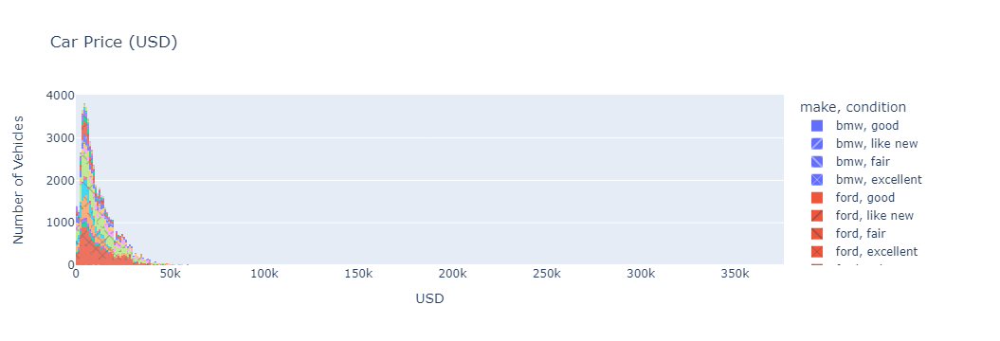

In [155]:
fig = px.histogram(data, 'price', color='make',  pattern_shape='condition', nbins=500,
             title='Car Price (USD)',
             labels={'price':'USD',
                     'count':'Number of Vehicles'}, # can specify one label per df column
             opacity=0.8
            )
# Update y-axis label using update_yaxes
fig.update_yaxes(title_text='Number of Vehicles')
fig.show()

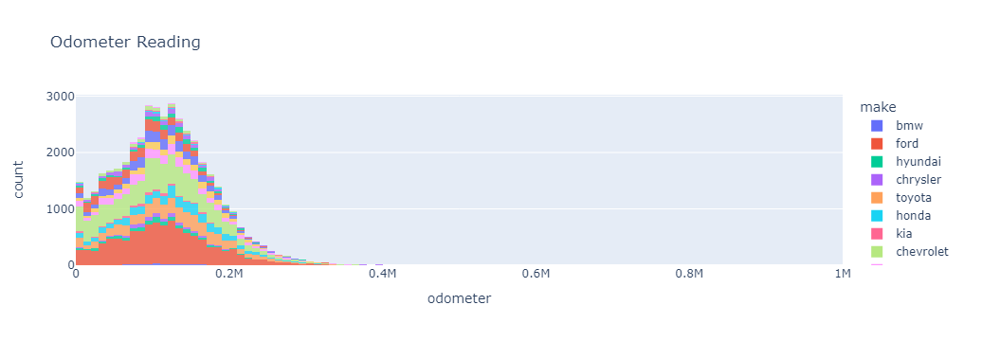

In [156]:
fig = px.histogram(data, 'odometer', color='make', nbins=100,
                   title='Odometer Reading',
                   labels={'count':'Number of Vehicles'}, # can specify one label per df column
                   opacity=0.8,
                   )
fig.update_yaxes(title_text='Number of Vehicles')
fig.show()

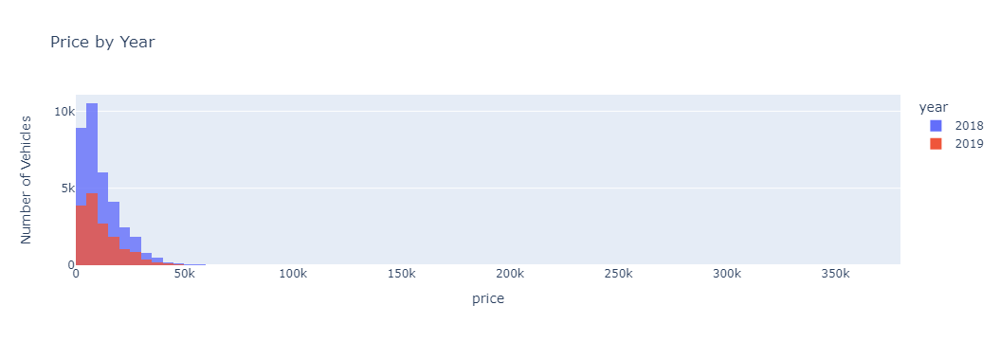

In [166]:
fig = px.histogram(data, 'price', color='year', nbins=100,
                   barmode='overlay',
                   title='Price by Year',
                   labels={'count':'Number of Vehicles'}, # can specify one label per df column
                   opacity=0.8,
                   )
fig.update_yaxes(title_text='Number of Vehicles')
fig.show()

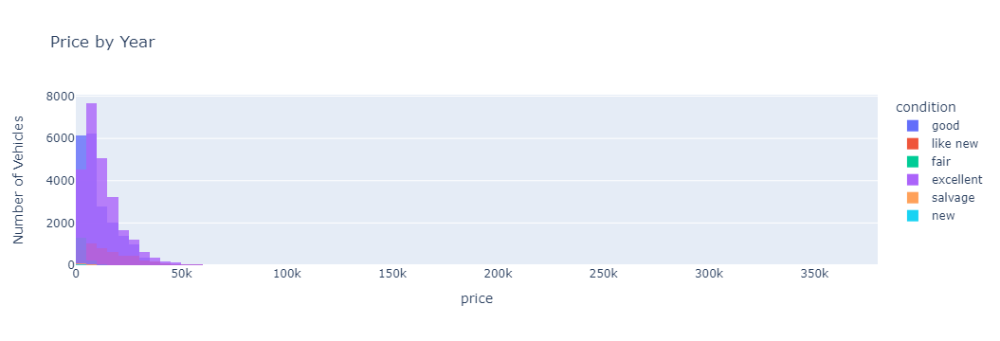

In [167]:
fig = px.histogram(data, 'price', color='condition', nbins=100,
                   barmode='overlay',
                   title='Price by Year',
                   labels={'count':'Number of Vehicles'}, # can specify one label per df column
                   opacity=0.8,
                   )
fig.update_yaxes(title_text='Number of Vehicles')
fig.show()

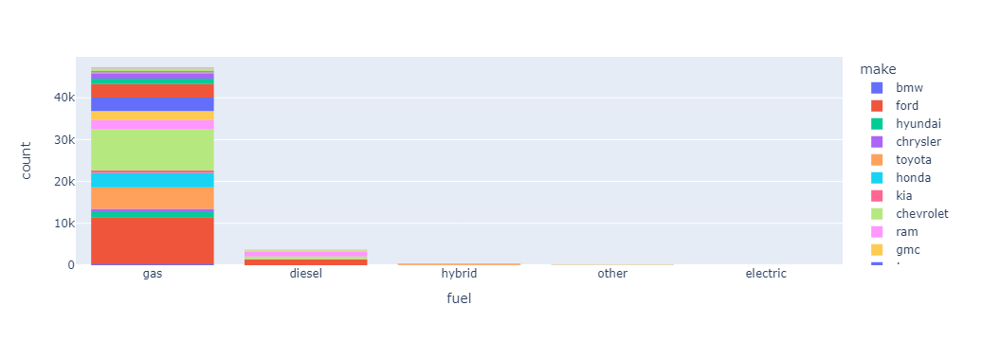

In [154]:
px.histogram(data, x='fuel', color='make')

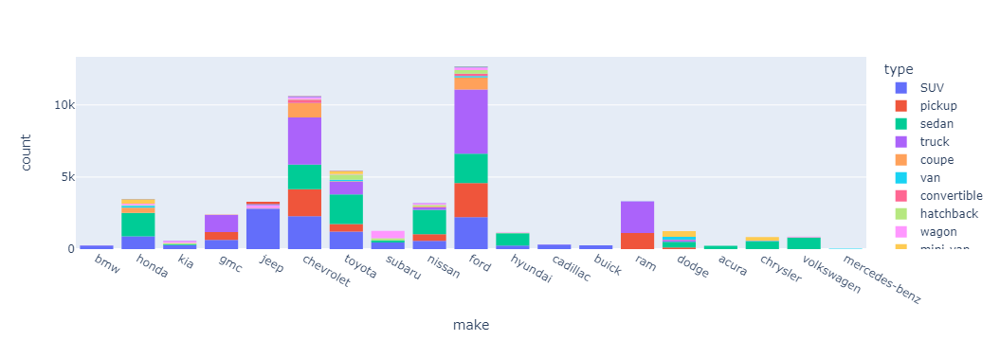

In [147]:
px.histogram(data, x='make', color='type',
             
            )

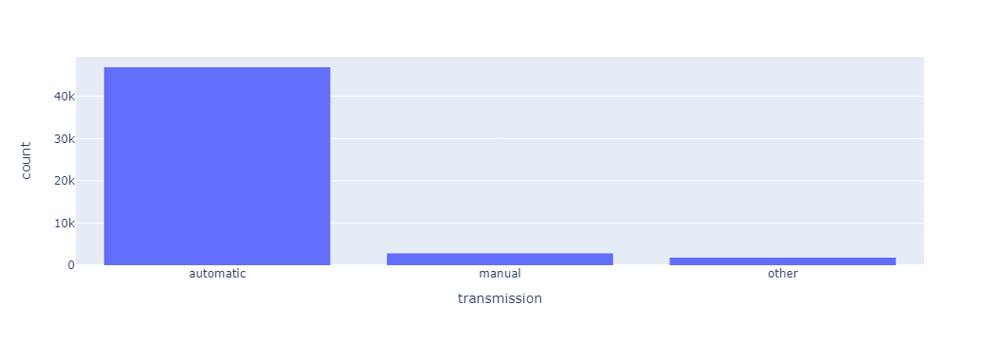

In [13]:
px.histogram(data, x='transmission')

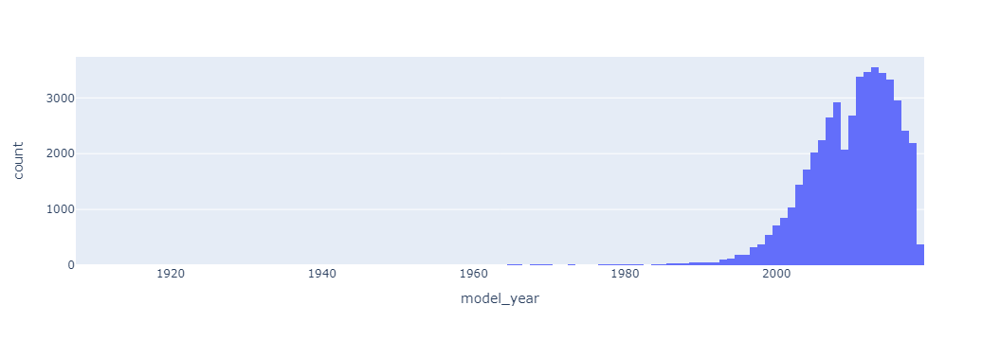

In [14]:
px.histogram(data, x='model_year')

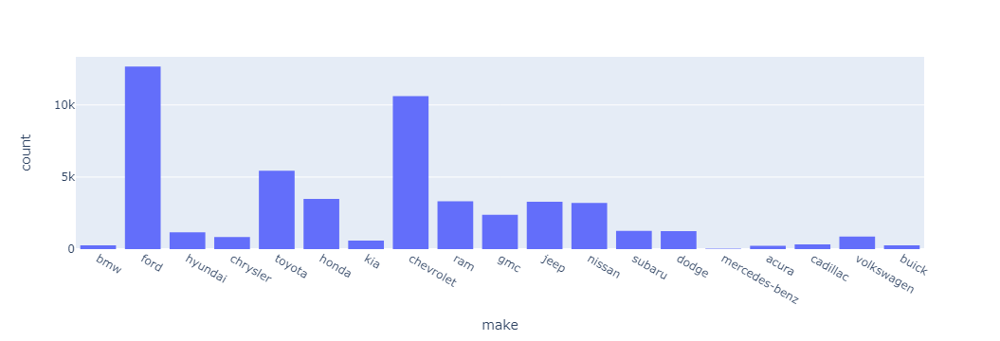

In [18]:
px.histogram(data, x='make')

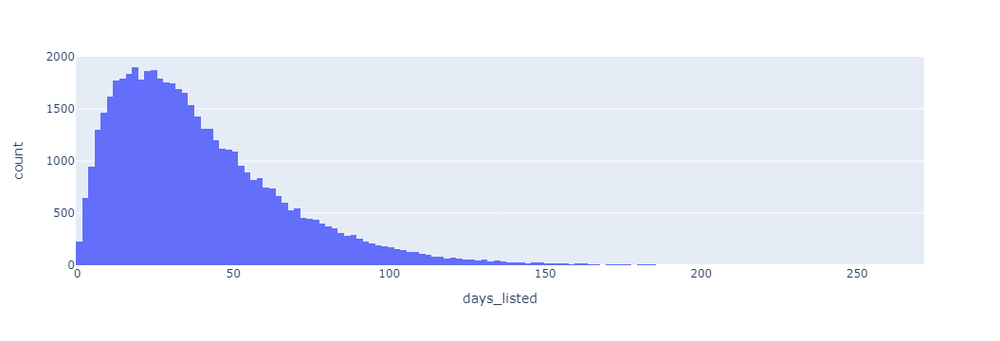

In [21]:
px.histogram(data, x='days_listed', nbins=200)

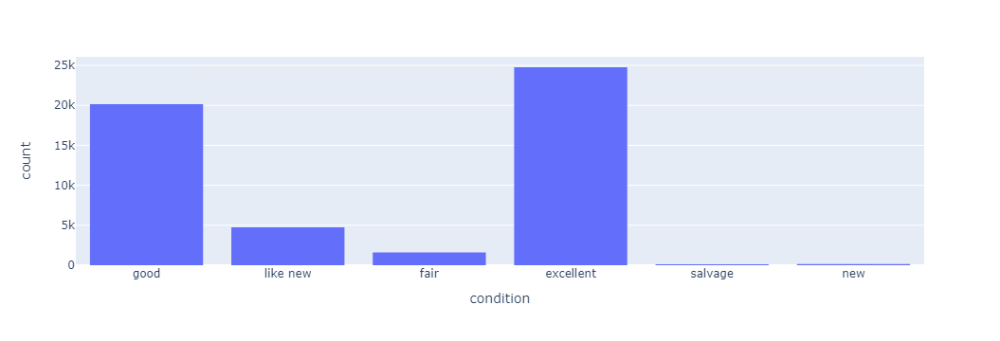

In [38]:
px.histogram(data, x='condition')

In [ ]:
# Comparison by 


In [24]:
data['odometer'].max()

990000.0

In [53]:
data.query('make == @make')['model'].value_counts()

model
x5    267
Name: count, dtype: int64

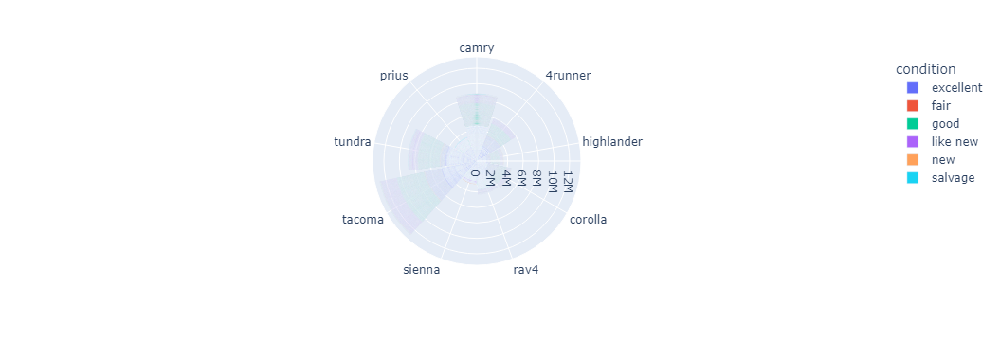

In [62]:
# Polar bar charts
make = 'toyota'
fig = px.bar_polar(data.query('make == @make').sort_values('condition'), r='price', theta='model',
                   color='condition' , )
# template='plotly_dark', color_discrete_sequence= px.colors.sequential.Plasma_r)
fig.show()

In [60]:
data.query('make == @make').sort_values('condition')

,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,is_4wd,date_posted,days_listed,make,year,month,day,day_of_week
6,12990.0,2015,camry,excellent,4.0,gas,79212.0,automatic,sedan,white,NaN,2018-12-27,73,toyota,2018,December,27,Thursday
29824,33000.0,2015,4runner,excellent,6.0,gas,70100.0,automatic,SUV,white,1.0,2019-01-20,5,toyota,2019,January,20,Sunday
29890,13975.0,2013,highlander,excellent,6.0,gas,111149.0,automatic,SUV,white,1.0,2018-10-08,54,toyota,2018,October,8,Monday
29911,20300.0,2015,highlander,excellent,6.0,gas,69000.0,automatic,SUV,grey,1.0,2018-10-27,82,toyota,2018,October,27,Saturday
29972,16995.0,2016,corolla,excellent,4.0,gas,33100.0,automatic,sedan,white,NaN,2018-07-02,95,toyota,2018,July,2,Monday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7656,11000.0,2014,tacoma,salvage,4.0,gas,64046.0,automatic,pickup,white,NaN,2018-11-18,78,toyota,2018,November,18,Sunday
27192,1200.0,<NA>,rav4,salvage,4.0,gas,NaN,automatic,SUV,green,1.0,2018-10-19,21,toyota,2018,October,19,Friday
686,999.0,1995,4runner,salvage,6.0,gas,164221.0,automatic,SUV,red,NaN,2018-05-03,33,toyota,2018,May,3,Thursday
45719,9900.0,2015,prius,salvage,4.0,hybrid,54000.0,automatic,sedan,blue,NaN,2019-03-27,46,toyota,2019,March,27,Wednesday


In [70]:
data.head(5)

,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,is_4wd,date_posted,days_listed,make,model_only,year,month,day,day_of_week
0,9400.0,2011,bmw x5,good,6.0,gas,145000.0,automatic,SUV,NaN,1.0,2018-06-23,19,bmw,x5,2018,June,23,Saturday
1,25500.0,<NA>,ford f-150,good,6.0,gas,88705.0,automatic,pickup,white,1.0,2018-10-19,50,ford,f-150,2018,October,19,Friday
2,5500.0,2013,hyundai sonata,like new,4.0,gas,110000.0,automatic,sedan,red,NaN,2019-02-07,79,hyundai,sonata,2019,February,7,Thursday
3,1500.0,2003,ford f-150,fair,8.0,gas,NaN,automatic,pickup,NaN,NaN,2019-03-22,9,ford,f-150,2019,March,22,Friday
4,14900.0,2017,chrysler 200,excellent,4.0,gas,80903.0,automatic,sedan,black,NaN,2019-04-02,28,chrysler,200,2019,April,2,Tuesday


In [81]:
# Parallel Coordinates
make = 'honda'
fig = px.parallel_coordinates(data.query('make == @make'), 
                              color='model_only',
                              labels={'model_only':'Model', 'model_year':'Model Year', },#'condition':'Condition', 'transmission':'Transmission'},
                              color_continuous_scale=px.colors.qualitative.Set3,
                              # color_continuous_midpoint=2
                             )

                              

# Hide the color scale that is useless in this case
fig.update_layout(coloraxis_showscale=False)

# Show the plot
fig.show()

ValueError: 
    Invalid element(s) received for the 'color' property of parcoords.line
        Invalid elements include: ['pilot', 'pilot', 'accord', 'cr-v', 'civic', 'accord', 'pilot', 'accord', 'cr-v', 'cr-v']

    The 'color' property is a color and may be specified as:
      - A hex string (e.g. '#ff0000')
      - An rgb/rgba string (e.g. 'rgb(255,0,0)')
      - An hsl/hsla string (e.g. 'hsl(0,100%,50%)')
      - An hsv/hsva string (e.g. 'hsv(0,100%,100%)')
      - A named CSS color:
            aliceblue, antiquewhite, aqua, aquamarine, azure,
            beige, bisque, black, blanchedalmond, blue,
            blueviolet, brown, burlywood, cadetblue,
            chartreuse, chocolate, coral, cornflowerblue,
            cornsilk, crimson, cyan, darkblue, darkcyan,
            darkgoldenrod, darkgray, darkgrey, darkgreen,
            darkkhaki, darkmagenta, darkolivegreen, darkorange,
            darkorchid, darkred, darksalmon, darkseagreen,
            darkslateblue, darkslategray, darkslategrey,
            darkturquoise, darkviolet, deeppink, deepskyblue,
            dimgray, dimgrey, dodgerblue, firebrick,
            floralwhite, forestgreen, fuchsia, gainsboro,
            ghostwhite, gold, goldenrod, gray, grey, green,
            greenyellow, honeydew, hotpink, indianred, indigo,
            ivory, khaki, lavender, lavenderblush, lawngreen,
            lemonchiffon, lightblue, lightcoral, lightcyan,
            lightgoldenrodyellow, lightgray, lightgrey,
            lightgreen, lightpink, lightsalmon, lightseagreen,
            lightskyblue, lightslategray, lightslategrey,
            lightsteelblue, lightyellow, lime, limegreen,
            linen, magenta, maroon, mediumaquamarine,
            mediumblue, mediumorchid, mediumpurple,
            mediumseagreen, mediumslateblue, mediumspringgreen,
            mediumturquoise, mediumvioletred, midnightblue,
            mintcream, mistyrose, moccasin, navajowhite, navy,
            oldlace, olive, olivedrab, orange, orangered,
            orchid, palegoldenrod, palegreen, paleturquoise,
            palevioletred, papayawhip, peachpuff, peru, pink,
            plum, powderblue, purple, red, rosybrown,
            royalblue, rebeccapurple, saddlebrown, salmon,
            sandybrown, seagreen, seashell, sienna, silver,
            skyblue, slateblue, slategray, slategrey, snow,
            springgreen, steelblue, tan, teal, thistle, tomato,
            turquoise, violet, wheat, white, whitesmoke,
            yellow, yellowgreen
      - A number that will be interpreted as a color
        according to parcoords.line.colorscale
      - A list or array of any of the above

In [107]:
data['make'].unique()

array(['bmw', 'ford', 'hyundai', 'chrysler', 'toyota', 'honda', 'kia',
       'chevrolet', 'ram', 'gmc', 'jeep', 'nissan', 'subaru', 'dodge',
       'mercedes-benz', 'acura', 'cadillac', 'volkswagen', 'buick'],
      dtype=object)

In [13]:
def make_parallel_coords(make):
    # Convert the categorical variable to numeric codes
    data_filtered = data.query('make == @make').copy()
    data_filtered['model_code'] = pd.Categorical(data_filtered['model_only']).codes
    
    # Define a custom color mapping for each model
    unique_models = data_filtered['model_only'].unique()
    color_map = {model: color for model, color in zip(unique_models, px.colors.qualitative.Pastel)}
    
    # Map the numeric codes back to colors
    data_filtered['color'] = data_filtered['model_only'].map(color_map)
    
    # Plot using the numeric codes for color
    fig = px.parallel_coordinates(
        data_filtered.drop(columns=['is_4wd', 'day']), #[['odometer', 'cylinders', 'price', 'transmission', 'condition', 'model_code']],
        color='model_code',
        labels={
            'model_year': 'Model Year',
            'model_code': 'Model',
            'price': 'Price',
            'cylinders': 'Cylinders',
            'odometer': 'Odometer',
            'days_listed': 'Days Listed',
            'year': 'Year',
            
        },
        color_continuous_scale=px.colors.qualitative.Set3
    )
    
    # Create annotations for the correspondence between model_code and model_only
    annotations = []
    for i, model in enumerate(unique_models):
        annotations.append(
            go.layout.Annotation(
                x=1.1,  # Position it outside the plot area
                y=1 - (i * 0.1),  # Space them vertically
                xref="paper",
                yref="paper",
                showarrow=False,
                text=f"{i} = {model}",
                font=dict(color=color_map[model], size=12)
            )
        )
    
    # Update the layout to include the annotations
    fig.update_layout(annotations=annotations, margin=dict(r=200))  # Adjust the margin to make space for the annotations
    
    # Hide the color scale that is useless in this case
    fig.update_layout(coloraxis_showscale=False)
    
    fig.show()

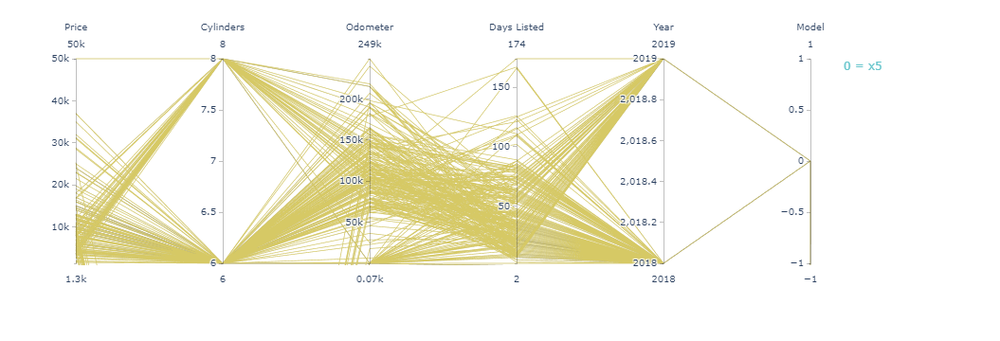

In [14]:
# Parallel Coordinates
for make in data['make'].unique():
    try:
        make_parallel_coords(make)
    except Exception as e:
        print(f"Error found!")
    break

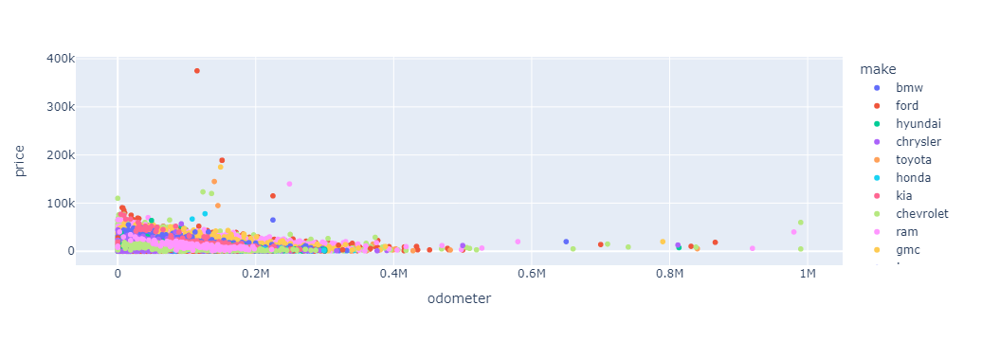

In [164]:
# Scatter plot
make = 'honda'
px.scatter(data, x='odometer', y='price', color='make')

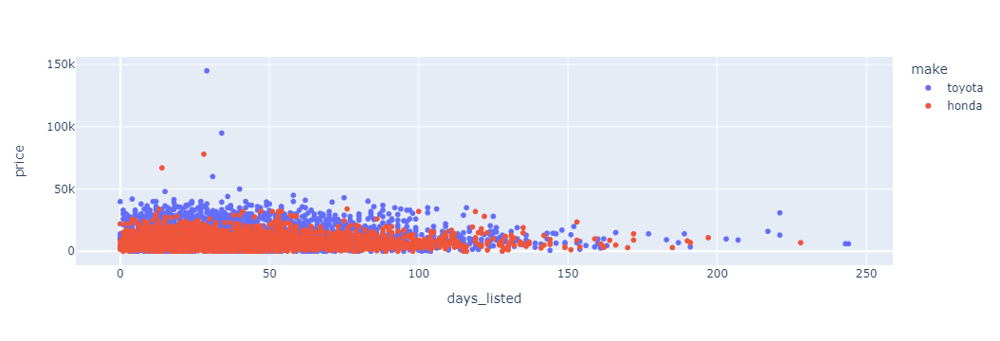

In [163]:
make = ['honda', 'toyota']
px.scatter(data.query('make == @make'), x='days_listed', y='price', color='make')